# Homework 2: Numerical Methods

## Marko Brnovic

The main goal of this Homework is to solve the scalar wave equation
\begin{equation}
    \frac{\partial^2 \phi}{\partial t^2} = \Delta \phi
\end{equation}

on the surface of a sphere. To discretize $\phi(t, \theta, \phi)$ in space, we recommend using spherical harmonic functions $Y_{lm}$. The Laplace operator for spherical harmonics is a diagonal operator given by the factor $-l(l + 1)$ for each $c_{lm}$ (i.e., it is independent of the mode number $m$). This will lead to a system of ODEs for the coefficient vector $c_{lm}$.
To discretize $\phi$ in time, we want to use standard ODE methods. These standard methods assume that there is only a first derivative in time. We thus introduce a new function $\psi = \frac{\partial \phi}{\partial t}$, arriving at the system
\begin{align}
    \frac{\partial \phi}{\partial t} &= \psi  \\
    \frac{\partial \psi}{\partial t} &= \Delta \phi 
\end{align}

Both functions $\phi$ and $\psi$ need to be expanded in spherical harmonics, i.e., the coefficient vector is now twice as long.

Note: You can use the package SphericalFunctions to obtain the spherical harmonics functions $Y_{lm}$.

### Questions

##### a) Numerically implement the discretization of $\phi$ in terms of spherical harmonics.

On a sphere, we have two continuous parameters $\theta$ and $\phi$. Using the hint, we can use an ansatz for $\phi$ and reformulate this continuous dependence into a discrete dependence of the spherical harmonics. Einstein summation convention is implied. Namely, we will say
\begin{equation}
    \phi =  c^{lm}(t)\; Y_{lm}(\theta, \phi)
\end{equation}

Plugging this into the first equation we get
\begin{equation}
     \ddot{c}^{lm}(t)\; Y_{lm}(\theta, \phi) = -l(l + 1)\; c^{lm}(t)\; Y_{lm}(\theta, \phi)
\end{equation}

\begin{equation}
    \implies  \ddot{c}^{lm}(t) = -l(l + 1)\; c^{lm}(t),
\end{equation}
so effectively, the ansatz helped us to transform the pde into an ode.



In [1]:
# using Pkg
# Pkg.add("SphericalHarmonics")
# Pkg.add("HCubature")
# Pkg.add("PlotlyJS")
# Pkg.add("PyPlot")
using SphericalHarmonics
using HCubature
using Plots; pyplot()
using DifferentialEquations

In [2]:
# Defining the spherical domain

n = 100
θ = LinRange(0,π,n);
ϕ = LinRange(0,2π,n);
xx = @. sin(θ)*cos(ϕ');
yy = @. sin(θ)*sin(ϕ');
zz = @. cos(θ)*ones(n)';

In [3]:
# This function takes an initial distribution over a sphere and represents it in a basis of spherical harmonics. The output is a vector that when
# multiplied with the spherical harmonics gives the init_con function

function phi(init_cond, l_max)
    coefficients = hcubature(x -> computeYlm(x[1], x[2], l_max) * init_cond(x[1], x[2]), [0.0, 0.0], [pi, 2*pi])[1]
    return coefficients
end

phi (generic function with 1 method)

##### b) Use an initial condition that is peaked around the North Pole, i.e., that looks similar to a Gaussian with a width equal to 0.2. (The exact initial condition does not matter).

##### At the north pole, $\theta = 0$, $\phi$ is degenerate. 

In [4]:
function gaussian(θ, φ)
    return exp(-θ^2 / (2*0.2)^2)
end

gaussian (generic function with 1 method)

In [5]:
testing_coefficients = phi(gaussian, 10);

In [6]:
testing = zeros(Complex{Float64}, 100, 100)
for i in 1:100
    for j in 1:100
        testing[i,j] = testing_coefficients' * computeYlm(0 + pi/100 * i, 0 + pi/50 * j, 10) / 100
    end
end

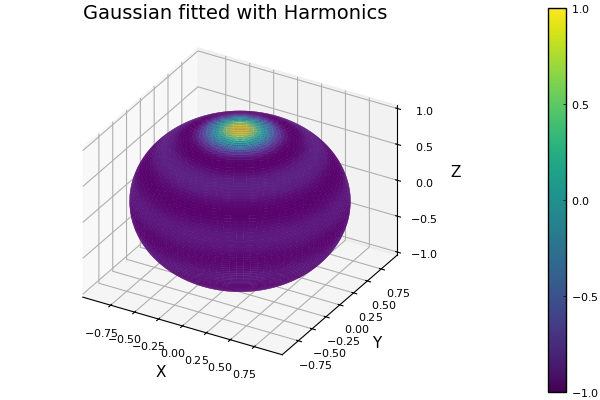

In [7]:
surface(xx, yy, zz, fill_z = real.(testing), c=:viridis, xlabel = "X", ylabel = "Y", zlabel = "Z", title = "Gaussian fitted with Harmonics")

In [8]:
testing_true = zeros(100, 100)

for i in 1:100
    for j in 1:100
        testing_true[i,j] = gaussian(0 + pi/100 * i, 0 + pi/50 * j)
    end
end

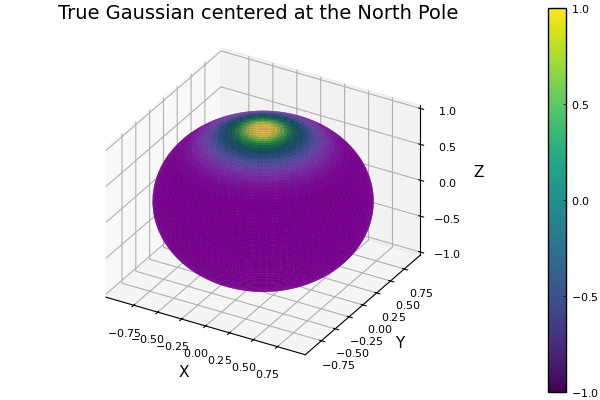

In [9]:
surface(xx, yy, zz, fill_z = real.(testing_true), c=:viridis, xlabel = "X", ylabel = "Y", zlabel = "Z", title = "True Gaussian centered at the North Pole")

The above two plots agree, meaning we were successful with decomposing our Gaussian into spherical harmonics. The more spherical harmonics we use (here we used only 10), the closer the two get. This means we can now proceed with solving the ODE for the time-dependent coefficients.

##### c) Evolve the system in time to see from $t = 0$ to $t = 10$ using your favorite ODE integrator. The resulting evolution should look similar to water waves moving on the surface of a pond, except that the pond is the surface of a sphere.

In [10]:
# Function that generates a list of l's that I will use in my ODE, based on the lmax value

function generate_ls(lmax)
    ls = []
    for i in 1:lmax + 1
        append!(ls, fill(i - 1, 2i - 1))
    end
    return ls
end

generate_ls (generic function with 1 method)

In [11]:
# Define the function for the system of ODEs
function ode_system!(du, u, p, t)
    l = p[1]
    du[1] = u[2]  # First derivative of c
    du[2] = - l * (l + 1) * u[1]  # Second derivative of c
end

ode_system! (generic function with 1 method)

In [12]:
# Global variables
l_max = 20;

# Initial conditions (derivatives are random)
c0 = phi(gaussian, l_max);
c0der = rand(length(c0));

tspan = (0.0, 10.0); # Time span

# Define the values of l for each c
ls = generate_ls(l_max); # Example values of l for each c

In [13]:
# Create an array to store the solutions
allsolutions = []

# Solve the ODE for each c
for i in 1:length(ls)
    l = ls[i]
    prob = ODEProblem(ode_system!, [c0[i], c0der[i]], tspan, [l])
    sol = solve(prob)
    push!(allsolutions, sol)
end

In [14]:
# Writing solutions in a discretised time setting

t_step = 0.1

solutions = []

for i in 1:length(ls)
    push!(solutions, [x[1] for x in real.(allsolutions[i](0:t_step:10))])
end

In [15]:
solutions = hcat(solutions...);

In [16]:
solution_array = zeros(101, 100, 100)
for k in 1:101
    for i in 1:100
        for j in 1:100
            solution_array[k,i,j] = solutions[k,:]' * real.(computeYlm(0 + pi/100 * i, 0 + pi/50 * j, 20))
        end
    end
end

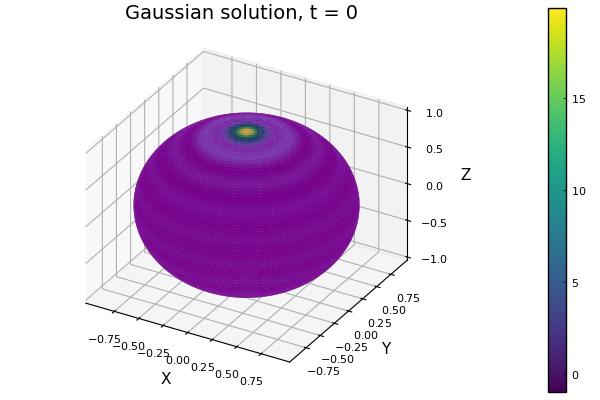

In [17]:
surface(xx, yy, zz, fill_z = real.(solution_array[1,:,:]), c=:viridis, xlabel = "X", ylabel = "Y", zlabel = "Z", title = "Gaussian solution, t = 0")

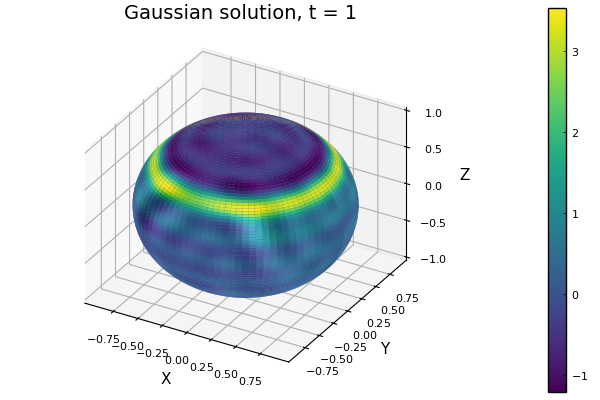

In [18]:
surface(xx, yy, zz, fill_z = real.(solution_array[10,:,:]), c=:viridis, xlabel = "X", ylabel = "Y", zlabel = "Z", title = "Gaussian solution, t = 1")

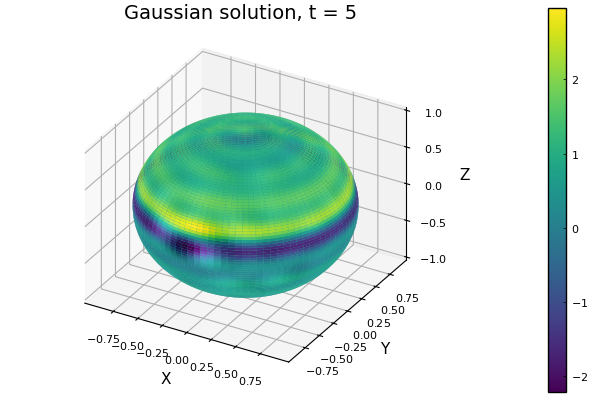

In [19]:
surface(xx, yy, zz, fill_z = real.(solution_array[50,:,:]), c=:viridis, xlabel = "X", ylabel = "Y", zlabel = "Z", title = "Gaussian solution, t = 5")

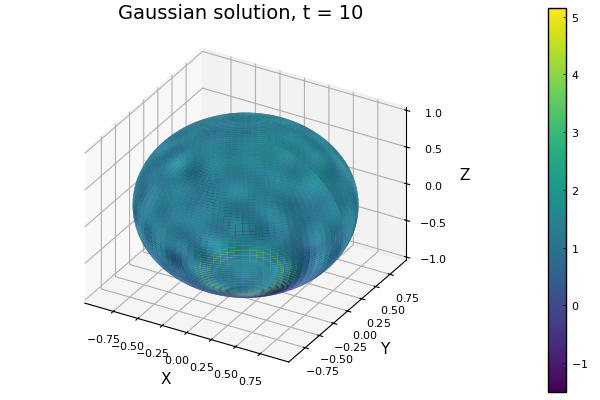

In [20]:
surface(xx, yy, zz, fill_z = real.(solution_array[100,:,:]), c=:viridis, xlabel = "X", ylabel = "Y", zlabel = "Z", title = "Gaussian solution, t = 10")

##### d) Create a series of figures or a movie that shows how the solution $\phi$ evolves in time. Perform the simulation three times with different choices of $l_{\text{max}}$, and at least one of these with a small $l_{\text{max}}$ (e.g., $l_{\text{max}} = 4$) to study the influence of the cut-off $l_{\text{max}}$.

In [21]:
# Global variables
l_max1 = 4;
l_max2 = 10;
l_max3 = 20;

# Initial conditions (derivatives are random)
c01 = phi(gaussian, l_max1);
c0der1 = rand(length(c01));

c02 = phi(gaussian, l_max2);
c0der2 = rand(length(c02));

c03 = phi(gaussian, l_max3);
c0der3 = rand(length(c03));

# Define the values of l for each c
ls1 = generate_ls(l_max1); # Example values of l for each c
ls2 = generate_ls(l_max2); # Example values of l for each c
ls3 = generate_ls(l_max3); # Example values of l for each c

In [22]:
# Create an array to store the solutions
solutions1 = []
solutions2 = []
solutions3 = []

Any[]

In [23]:
# Solve the ODE for each c
for i in 1:length(ls1)
    l = ls1[i]
    prob = ODEProblem(ode_system!, [c01[i], c0der1[i]], tspan, [l])
    sol1 = solve(prob)
    push!(solutions1, sol1)
end

In [24]:
# Solve the ODE for each c
for i in 1:length(ls2)
    l = ls2[i]
    prob = ODEProblem(ode_system!, [c02[i], c0der2[i]], tspan, [l])
    sol2 = solve(prob)
    push!(solutions2, sol2)
end

In [25]:
# Solve the ODE for each c
for i in 1:length(ls3)
    l = ls3[i]
    prob = ODEProblem(ode_system!, [c03[i], c0der3[i]], tspan, [l])
    sol3 = solve(prob)
    push!(solutions3, sol3)
end

In [26]:
# Writing solutions in a discretised time setting

t_step = 0.1

solutions1_eval = []
solutions2_eval = []
solutions3_eval = []

for i in 1:length(ls1)
    push!(solutions1_eval, [x[1] for x in real.(solutions1[i](0:t_step:10))])
end

for i in 1:length(ls2)
    push!(solutions2_eval, [x[1] for x in real.(solutions2[i](0:t_step:10))])
end

for i in 1:length(ls3)
    push!(solutions3_eval, [x[1] for x in real.(solutions3[i](0:t_step:10))])
end

In [27]:
solutions1_eval = hcat(solutions1_eval...);
solutions2_eval = hcat(solutions2_eval...);
solutions3_eval = hcat(solutions3_eval...);

In [28]:
solutions1_array = zeros(101, 100, 100)
solutions2_array = zeros(101, 100, 100)
solutions3_array = zeros(101, 100, 100)

for k in 1:101
    for i in 1:100
        for j in 1:100
            solutions1_array[k,i,j] = solutions1_eval[k,:]' * real.(computeYlm(0 + pi/100 * i, 0 + pi/50 * j, 4))
            solutions2_array[k,i,j] = solutions2_eval[k,:]' * real.(computeYlm(0 + pi/100 * i, 0 + pi/50 * j, 10))
            solutions3_array[k,i,j] = solutions3_eval[k,:]' * real.(computeYlm(0 + pi/100 * i, 0 + pi/50 * j, 20))
        end
    end
end

### l_max = 4

[ Info: Saved animation to C:\Users\mbrnovic\Desktop\Numerical Methods\tmp.gif


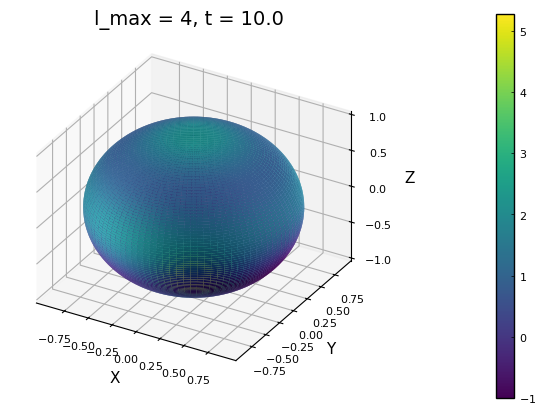

Plots.AnimatedGif("C:\\Users\\mbrnovic\\Desktop\\Numerical Methods\\tmp.gif")
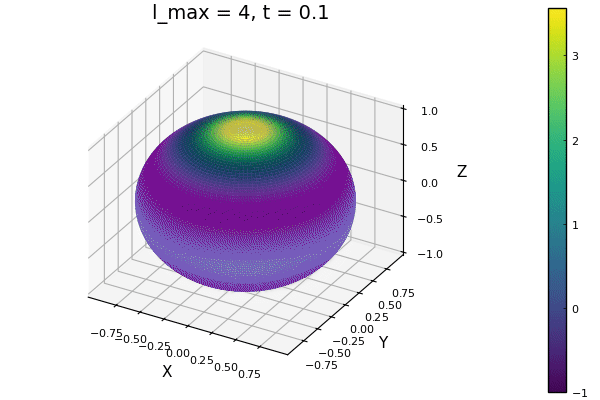

In [32]:
@gif for i in 1:100
    surface(xx, yy, zz, fill_z = solutions1_array[i,:,:], c=:viridis, xlabel = "X", ylabel = "Y", zlabel = "Z", title = "l_max = 4, t = $(i/10)")
end

### l_max = 10

[ Info: Saved animation to C:\Users\mbrnovic\Desktop\Numerical Methods\tmp.gif


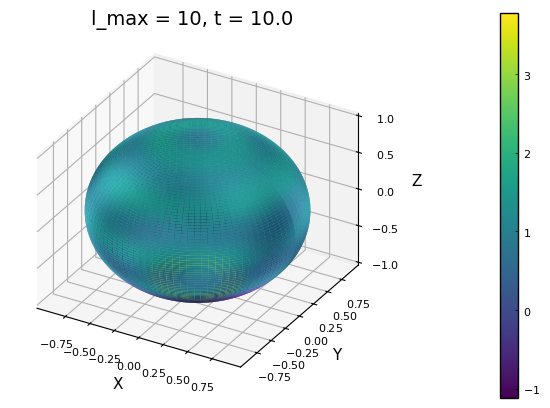

Plots.AnimatedGif("C:\\Users\\mbrnovic\\Desktop\\Numerical Methods\\tmp.gif")
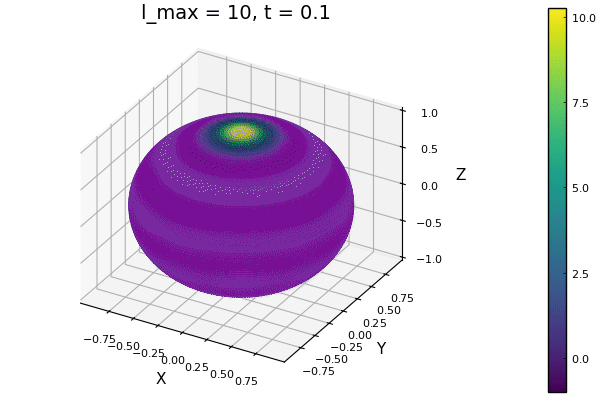

In [33]:
@gif for i in 1:100
    surface(xx, yy, zz, fill_z = solutions2_array[i,:,:], c=:viridis, xlabel = "X", ylabel = "Y", zlabel = "Z", title = "l_max = 10, t = $(i/10)")
end

### l_max = 20

[ Info: Saved animation to C:\Users\mbrnovic\Desktop\Numerical Methods\tmp.gif


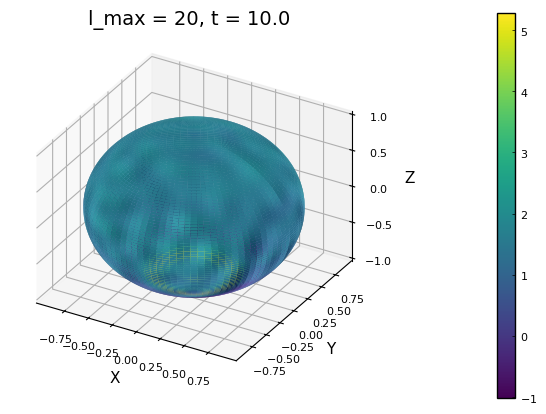

Plots.AnimatedGif("C:\\Users\\mbrnovic\\Desktop\\Numerical Methods\\tmp.gif")
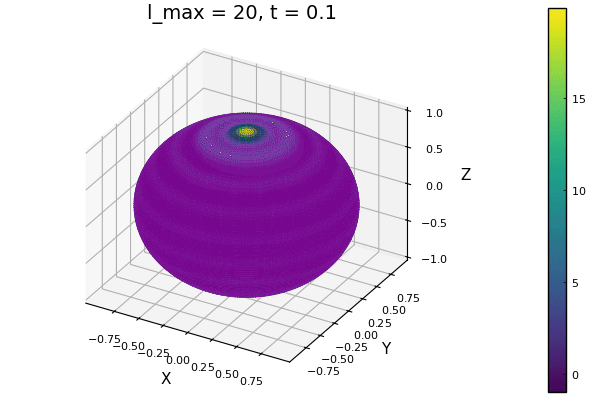

In [34]:
@gif for i in 1:100
    surface(xx, yy, zz, fill_z = solutions3_array[i,:,:], c=:viridis, xlabel = "X", ylabel = "Y", zlabel = "Z", title = "l_max = 20, t = $(i/10)")
end

I used ChatGPT for making the array 'ls' and for syntax when solving the ODE.